#  S2 L2A Maximum NDVI Mosaics via Sentinel-Hub Process API

### _Import functional dependencies and add repository source directory to system path_

In [1]:
import os
import yaml
from munch import munchify

In [2]:
# define repo name and get root working directory
repo = 'sentinelhub-py'
root_path = os.getcwd()[ 0 : os.getcwd().find( repo ) + len ( repo )]
root_path

'C:\\Users\\Chris.Williams\\Documents\\GitHub\\sentinelhub-py'

In [3]:
# add repo source + notebooks directory to system path
import sys
sys.path.insert(0, os.path.join( root_path, 'src' ) )
sys.path.insert(0, os.path.join( root_path, 'notebooks' ) )

In [4]:
# get path to configuration files
cfg_path = os.path.join( root_path, 'cfg' )
cfg_path = os.path.join( cfg_path, 'sentinel-2' )
cfg_path

'C:\\Users\\Chris.Williams\\Documents\\GitHub\\sentinelhub-py\\cfg\\sentinel-2'

### _Load configuration file from repository cfg sub-directory_ 

In [5]:
# get pathname to configuration file
cfg_file = os.path.join( cfg_path, 's2-mosaic-ndvi-max.yml' )

In [6]:
# print contents of configuration file
with open( cfg_file ) as f:
    print ( f.read() )

request:
    collection: SENTINEL2_L2A
    evalscript: |
                //VERSION=3
                function setup() {
                  return {
                    //List of all bands, that will be used in the script, either for visualization or for choosing best pixel
                    input: [{
                      bands: [
                         "B04",
                         "B08"
                      ]
                    }],
                    //This can always be the same if one is doing RGB images
                    output: { bands: 3 },
                    mosaicking: "ORBIT"
                  }
                }
                function calcNDVI(sample) {
                    var denom = sample.B04+sample.B08;
                    return ((denom!=0) ? (sample.B08-sample.B04) / denom : 0.0);
                }
                function evaluatePixel(samples) {  
                    var max = 0;
                    for (var i=0;i<samples.length;i++) {
                  

In [7]:
# load cfg file using yaml parser
with open( cfg_file, 'r' ) as f:
    config = munchify( yaml.safe_load( f ) )

### _Define area of interest collocated with farmland surrounding Boston, Lincolnshire_

In [8]:
# define min and max latlons
coords = -0.080200,52.953675,0.159439,53.106881
resolution = 10

In [9]:
# create instance of shclient class
from client import ShClient
client = ShClient( config )

In [10]:
# get utm bbox
bbox = client.getBoundingBox( coords )
print ( bbox, bbox.crs.value )

293092.7252755137,5871558.133187766,309861.7019756964,5887931.057813582 32631


In [11]:
# get aoi image dimensions
client.getBoxDimensions( bbox, resolution )

(1677, 1637)

### _Define monthly aggregation timeframes for 2020_

In [12]:
# construct mosaic aggregation timeframes covering March - September 2020
import calendar
from datetime import datetime

# set year
year = 2020

# for each month in year
timeframes = []
for month in range( 2, 13, 2 ):
    last_day = calendar.monthrange( year, month )[ -1 ]
    timeframes.append( { 'start' : datetime( year, month, 1, 0, 0, 0 ), 
                            'end' : datetime( year, month, last_day, 23, 59, 59 ) } )

timeframes

[{'start': datetime.datetime(2020, 2, 1, 0, 0),
  'end': datetime.datetime(2020, 2, 29, 23, 59, 59)},
 {'start': datetime.datetime(2020, 4, 1, 0, 0),
  'end': datetime.datetime(2020, 4, 30, 23, 59, 59)},
 {'start': datetime.datetime(2020, 6, 1, 0, 0),
  'end': datetime.datetime(2020, 6, 30, 23, 59, 59)},
 {'start': datetime.datetime(2020, 8, 1, 0, 0),
  'end': datetime.datetime(2020, 8, 31, 23, 59, 59)},
 {'start': datetime.datetime(2020, 10, 1, 0, 0),
  'end': datetime.datetime(2020, 10, 31, 23, 59, 59)},
 {'start': datetime.datetime(2020, 12, 1, 0, 0),
  'end': datetime.datetime(2020, 12, 31, 23, 59, 59)}]

### _Download monthly aggregated S2 L2A maximum NDVI mosaics using functionality of Process API client_

In [13]:
# get mosaic between timeframe at specified pixel resolution
response = client.getMosaics ( bbox, timeframes, resolution )
response._df

,default,start,end
0,"[[[15, 84, 10], [15, 84, 10], [15, 84, 10], [0...",2020-02-01,2020-02-29 23:59:59
1,"[[[163, 204, 89], [163, 204, 89], [163, 204, 8...",2020-04-01,2020-04-30 23:59:59
2,"[[[79, 138, 46], [79, 138, 46], [79, 138, 46],...",2020-06-01,2020-06-30 23:59:59
3,"[[[0, 69, 0], [0, 69, 0], [0, 69, 0], [0, 69, ...",2020-08-01,2020-08-31 23:59:59
4,"[[[15, 84, 10], [15, 84, 10], [15, 84, 10], [1...",2020-10-01,2020-10-31 23:59:59
5,"[[[163, 204, 89], [163, 204, 89], [163, 204, 8...",2020-12-01,2020-12-31 23:59:59


### _Visualise variability of NDVI across growing season in Lincolnshire_

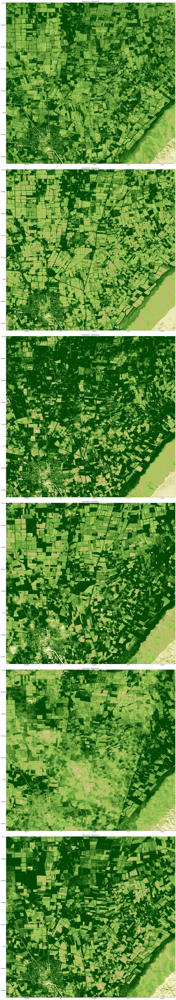

In [15]:
response.plotImages( 'default', alpha={ 'data': 1.0, 'grid' : 0.0 } )

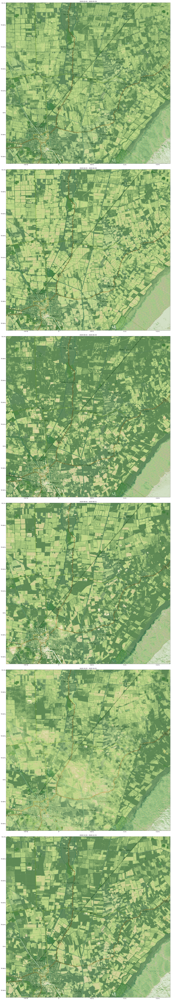

In [19]:
response.plotImages( 'default', osm_zoom=12, alpha={ 'data': 0.6, 'grid' : 0.6 } )